In this notebook we will implement the calculation of **CONSTANT HEIGHT STM IMAGES**.

**Some imports:**

In [1]:
import sisl
import sisl.viz
import numpy as np

Treball previ
-----

Construim la molècula de benzè:

In [4]:
from ase.collections import g2
print(g2.names)

['PH3', 'P2', 'CH3CHO', 'H2COH', 'CS', 'OCHCHO', 'C3H9C', 'CH3COF', 'CH3CH2OCH3', 'HCOOH', 'HCCl3', 'HOCl', 'H2', 'SH2', 'C2H2', 'C4H4NH', 'CH3SCH3', 'SiH2_s3B1d', 'CH3SH', 'CH3CO', 'CO', 'ClF3', 'SiH4', 'C2H6CHOH', 'CH2NHCH2', 'isobutene', 'HCO', 'bicyclobutane', 'LiF', 'Si', 'C2H6', 'CN', 'ClNO', 'S', 'SiF4', 'H3CNH2', 'methylenecyclopropane', 'CH3CH2OH', 'F', 'NaCl', 'CH3Cl', 'CH3SiH3', 'AlF3', 'C2H3', 'ClF', 'PF3', 'PH2', 'CH3CN', 'cyclobutene', 'CH3ONO', 'SiH3', 'C3H6_D3h', 'CO2', 'NO', 'trans-butane', 'H2CCHCl', 'LiH', 'NH2', 'CH', 'CH2OCH2', 'C6H6', 'CH3CONH2', 'cyclobutane', 'H2CCHCN', 'butadiene', 'C', 'H2CO', 'CH3COOH', 'HCF3', 'CH3S', 'CS2', 'SiH2_s1A1d', 'C4H4S', 'N2H4', 'OH', 'CH3OCH3', 'C5H5N', 'H2O', 'HCl', 'CH2_s1A1d', 'CH3CH2SH', 'CH3NO2', 'Cl', 'Be', 'BCl3', 'C4H4O', 'Al', 'CH3O', 'CH3OH', 'C3H7Cl', 'isobutane', 'Na', 'CCl4', 'CH3CH2O', 'H2CCHF', 'C3H7', 'CH3', 'O3', 'P', 'C2H4', 'NCCN', 'S2', 'AlCl3', 'SiCl4', 'SiO', 'C3H4_D2d', 'H', 'COF2', '2-butyne', 'C2H5', 'BF3'

In [5]:
from ase.build import molecule
benzene = molecule('C6H6', vacuum=5)

In [6]:
benzene

Atoms(symbols='C6H6', pbc=False, cell=[14.299574, 14.96472, 10.0])

Escribim la molècula en un fitxer i la representem:

In [7]:
geometry = sisl.Geometry.new(benzene)

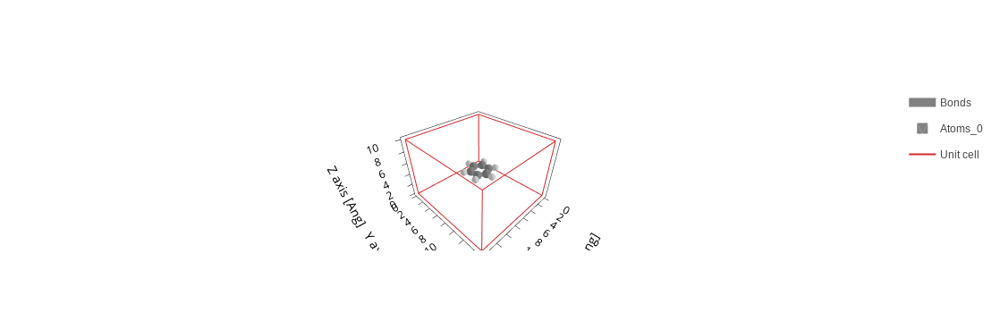

In [8]:
geometry.plot()

In [9]:
geometry.write('benzene.fdf')

Afegim "TS.HS.Save true" al fitxer .fdf i l'executem amb SIESTA per generar el Hamiltonià del benzè:

In [10]:
hamiltonian = sisl.get_sile("benzene.fdf").read_hamiltonian()
hamiltonian

<sisl.physics.Hamiltonian na=12, no=108, nsc=[1 1 1], dim=2, nnz=11658, spin=unpolarized>

Calculem els valors i vectors propis del sistema:

In [11]:
eigenstate = hamiltonian.eigenstate()
print("Els valors propis són:")
eigenstate.eig

Els valors propis són:


array([-16.85584921, -14.0856129 , -14.08561174, -10.53069213,
       -10.53054227,  -8.65691373,  -6.88636117,  -6.66710033,
        -5.94719358,  -5.94660128,  -4.7629345 ,  -3.947479  ,
        -3.9472216 ,  -2.0336825 ,  -2.0335716 ,   3.17039698,
         3.17043392,   6.11502598,   7.11138195,   7.63003778,
         7.63105022,   8.40580666,   8.40584601,   9.16184149,
        11.24458368,  11.24516225,  11.43573032,  11.43615096,
        11.82269438,  12.22032039,  12.44676789,  14.53391452,
        14.534041  ,  15.05254152,  15.05304262,  15.49873408,
        16.05283721,  16.05462092,  16.98877124,  17.24325958,
        17.47766281,  17.47772598,  18.04618741,  19.26995222,
        19.89849062,  21.96329687,  21.96476612,  22.06533538,
        22.06778255,  22.08878172,  22.08900384,  23.82259741,
        23.82262539,  24.69043576,  24.9404016 ,  24.94327857,
        25.9243249 ,  26.8633256 ,  26.8666338 ,  27.21287037,
        27.50885201,  28.22176221,  28.22599683,  29.59

In [12]:
print("La matriu de coeficients dels vectors propis és:")
eigenstate.state

La matriu de coeficients dels vectors propis és:


array([[-1.09925713e-01, -1.19827740e-01, -7.05316328e-02, ...,
        -9.40630466e-03,  4.52347454e-14,  1.62604286e-02],
       [-1.05468443e-01, -2.07729764e-01, -3.65206681e-02, ...,
        -1.32996208e-03,  4.59602246e-14,  1.68417616e-02],
       [ 8.12859825e-06,  1.60103299e-05,  2.81518425e-06, ...,
         1.69382054e-02, -7.79484619e-14, -2.09514135e-02],
       ...,
       [-1.01930569e+01,  5.65075698e+00, -5.30174661e+00, ...,
        -4.42861412e-01, -1.80700029e-11,  7.66495053e-01],
       [ 3.68230551e+00, -1.60928037e+00,  8.60129318e-01, ...,
        -1.43037395e-01,  3.46062363e-12,  2.47810531e-01],
       [-4.56808623e-07,  3.58166820e-07, -1.09764247e-08, ...,
         8.01078190e-01,  8.34977094e-15,  4.62464331e-01]])

Definim un grid (buit) de dimensions 100x100x100 i el representem en el pla xy:

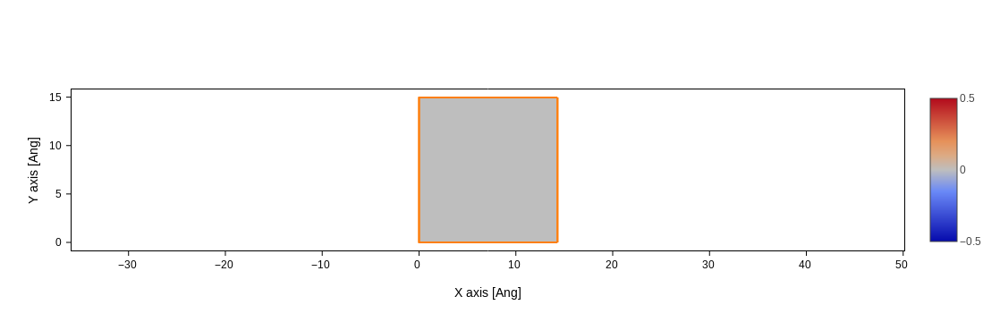

In [13]:
grid=sisl.Grid((100,100,100), geometry=geometry)
grid.plot(axes="xy")

Representem un grid 100x100x100 dels estats propis de la 1a funció d'ona:

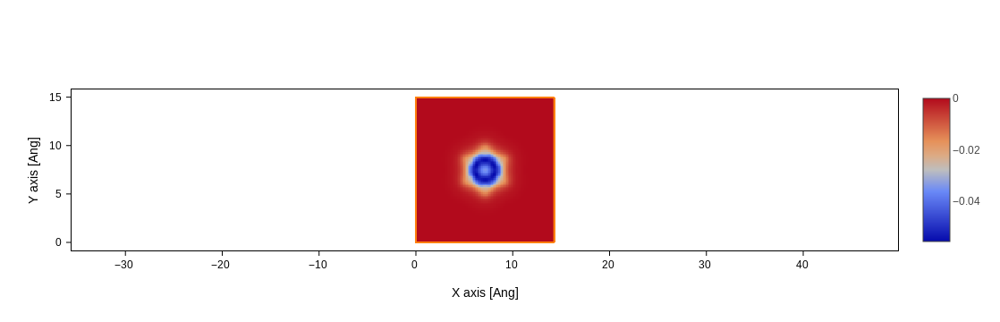

In [14]:
grid.fill(0)
eigenstate[0].wavefunction(grid)
grid.plot(axes='xy')

**LDOS del primer estat propi**

Calculem la matriu de coeficients pel primer estat propi:

In [15]:
eigenstate.state[0]

array([-1.09925713e-01, -1.19827740e-01, -7.05316328e-02,  1.74169437e-13,
        6.00793447e-10, -1.72112596e-02, -4.87539655e-13, -5.41782737e-10,
       -7.05169186e-11,  3.63048290e-14,  2.35167625e-03, -1.74942700e-16,
       -3.15113221e-03, -1.10474195e-01, -1.19486586e-01, -3.54451898e-02,
        1.67187488e-13, -6.13195814e-02, -8.46413203e-03, -4.82890932e-13,
       -1.47240589e-02,  2.66831557e-03,  1.77601869e-14,  2.37315443e-03,
        3.13201960e-14,  1.55625946e-03, -1.10474195e-01, -1.19486585e-01,
        3.54451863e-02,  1.76124831e-13, -6.13195837e-02,  8.46413473e-03,
       -4.89240830e-13, -1.47240570e-02, -2.66831448e-03, -1.84435296e-14,
        2.37315443e-03,  3.12892566e-14,  1.55625976e-03, -1.09925713e-01,
       -1.19827740e-01,  7.05316320e-02,  1.72353298e-13, -2.40388942e-09,
        1.72112603e-02, -4.86682586e-13,  1.96070041e-09, -8.18679462e-10,
       -3.60768752e-14,  2.35167630e-03,  2.91433132e-16, -3.15113240e-03,
       -1.10474194e-01, -

Representem els LDOS pel primer estat propi (per calcular el LDOS multipliquem la funció d'ona del primer estat pel seu conjugat). En el cas del benzè, les funcions d'ona no tenen component imaginari pel que el conjugat de la funció és ella mateixa.

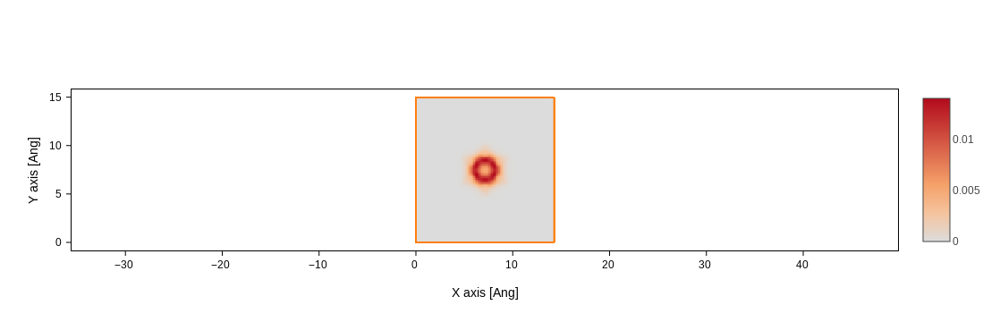

In [16]:
grid1=sisl.Grid((100,100,100), geometry=geometry)
eigenstate[0].wavefunction(grid1)
G1_LDOS = grid1*grid1 
G1_LDOS.plot(axes='xy')

**LDOS total de la molècula de benzé**

Calculem la LDOS total del benzé. Per fer-ho seguïm la següent estratègia:
- Creem un grid "G" inicialment buit.
- Creem un grid temporal "grid_t" que anirà variant.
- Definim un bucle on calculem la LDOS per cada funció d'ona (que ho gaurdem en el grid "grid_t") i ho anem sumant al grid "G" (dins de cada esta del bucle, el grid "G" conté la infromació de la LDOS per tots aquells estats < n. 
- Representem el grid "G", que contindrà la informació de la LDOS de tot el sistema.

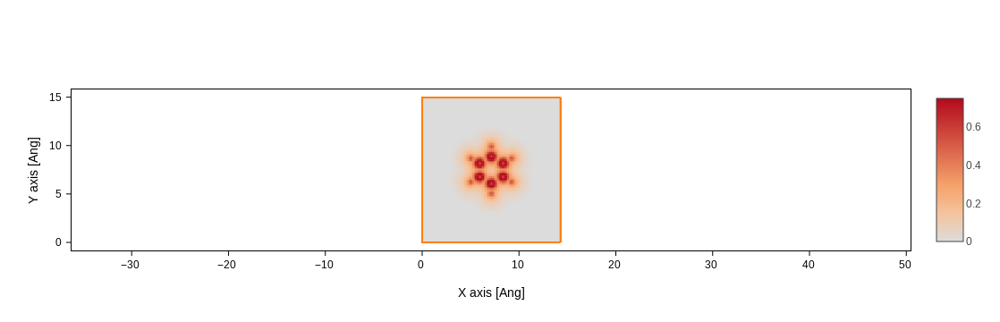

In [17]:
G = sisl.Grid((100,100,100), geometry=geometry)      # definim un grid buit que anomenem G
grid_t = sisl.Grid((100,100,100), geometry=geometry) # definim un grid buit que anomenem grid_t 

for n in range(0,108):                               # definim un bucle que s'executi per les 108 funcions d'ona que tenim pel cas del benzè
    grid_t.fill(0)                                   # buidem tota la informaciò previament guardada al grid_t
    eigenstate[n].wavefunction(grid_t)               # calculem la funció d'ona de l'estat n
    G_n = grid_t*grid_t                              # calculem la LDOS de l'estat n
    G = G + G_n                                      # sumem la LDOS de l'estat n al grid G

G.plot(axes='xy')                                    # representem la LDOS total

NOTA: El SIESTA ha utilitzat orbitals DZP per generar el Hamiltonià de l'estructura (i.e. 108 orbitals). Això fa que tinguem 108 estats propis.

Intensitat imatges STM en funció del voltatge
------

Calculem la LDOS de tots els estats que tenim en una energia entre 0 i 10 eV (i.e. la LDOS que observaríem amb un STM en aplicar una diferència de potencial de -10 V)

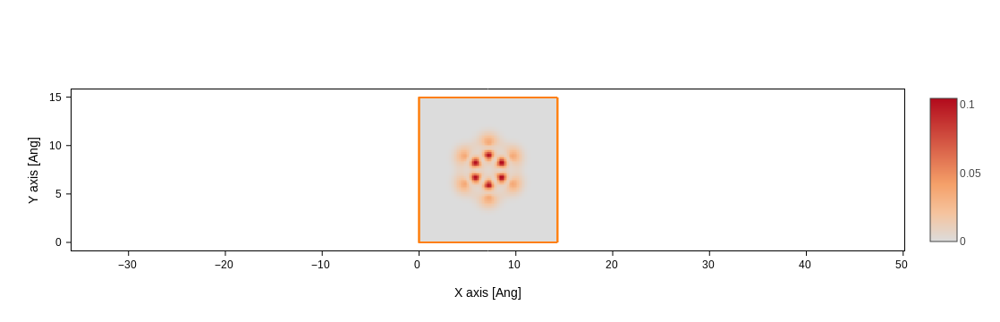

In [18]:
G.fill(0)                                   # buidem la informació que tenim guardada al grid G
V=10                                        # fixem l'energia fins on volem avaluar els LDOS (en aquets cas 10 eV).

for n in range(0,108):                      # definim un bucle que s'executi per les 108 funcions d'ona que tenim pel cas del benzè 
    
    if 0<eigenstate[n].eig<V:               # definim un condicional de mode que el que precedeuxi només s'executi per estats amb un valor propi amb energies entre 0 i V
        grid_t.fill(0)                      # buidem la informació que tenim guardada al grid_t
        eigenstate[n].wavefunction(grid_t)  # calculem la funció d'ona de l'estat n
        G_n = grid_t*grid_t                 # calculem la LDOS de l'estat n
        G = G + G_n                         # sumem la LDOS de l'estat n al grid G

G.plot(axes='xy')                           # representem la LDOS total entre energies de 0 a V

Per poder representar les imatges STM per diferents voltatges sense haver d'escriure tot el codi anterior per cada voltatge definim una funció on el voltatge (i el hamiltonià) sigui una variable.

In [19]:
def STM_grid(V,H):                                        # definim una funció que depèn d "V" i "H" i anomenem "STM_grid"
    G = sisl.Grid((100,100,100), geometry=geometry)       # definim el grid G
    G.fill(0)                                             # buidem la informació del grid G
    grid_t = sisl.Grid((100,100,100), geometry=geometry)  # definim un grid buit que anomenem grid_t 
    eigenstate = H.eigenstate()                           # definim els valors propis del hamiltonià "H" com "eigenstate"
  
    for n in range(0,108):                                # definim un bucle que s'executi per les 108 funcions d'ona que tenim pel cas del benzè
            
        if 0<eigenstate[n].eig<V:                         # definim un condicional de mode que el que precedeuxi només s'executi per estats amb un valor propi amb energies entre 0 i V
            grid_t.fill(0)                                # buidem la informació que tenim guardada al grid_t
            eigenstate[n].wavefunction(grid_t)            # calculem la funció d'ona de l'estat n
            G_n = grid_t*grid_t                           # calculem la LDOS de l'estat n
            G = G + G_n                                   # sumem la LDOS de l'estat n al grid G
        
    return G                                              # retorna la LDOS en funció de les variables V i H indicades

Calculem la LDOS que obtenim pels estats d'energia entre 0 i 10 eV:

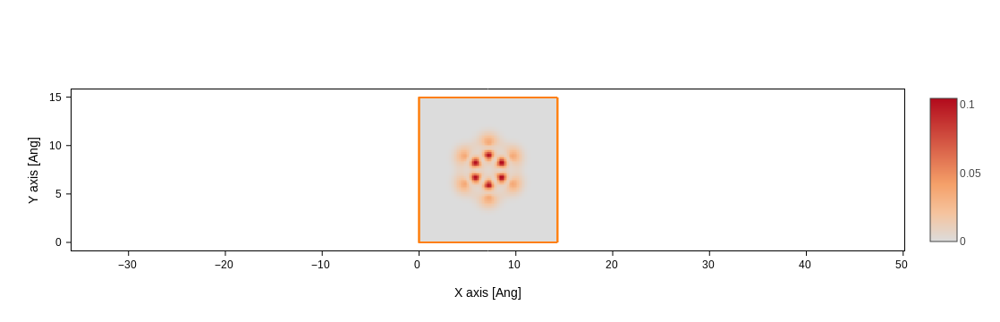

In [20]:
STM_grid(10,hamiltonian).plot(axes='xy')

PDOS
----

Representem la PDOS del benzè (per un rang de -10 eV a 10 eV):

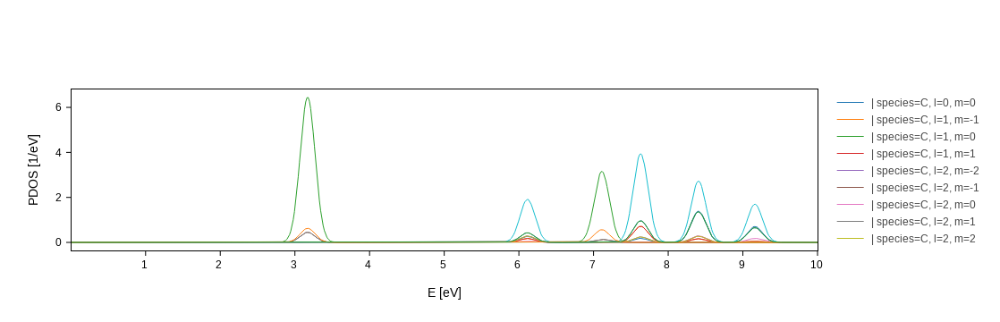

In [21]:
hamiltonian.plot.pdos(data_Erange=[-10, 10], nE=1200, Erange=[0, 10], kgrid=[1,1,1]).split_DOS(on="species+l+m")

Representem la PDOS del benzè (per un rang de 0 eV a 10 eV):

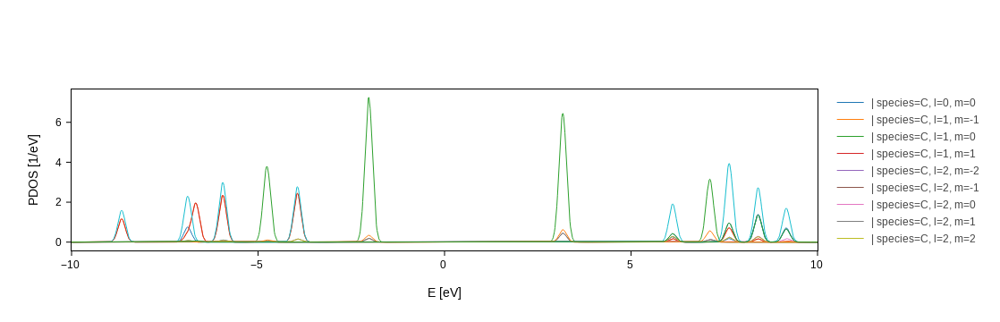

In [22]:
hamiltonian.plot.pdos(data_Erange=[-10, 10], nE=1200, Erange=[-10, 10], kgrid=[1,1,1]).split_DOS(on="species+l+m")

NOTA: Amb SIESTA, per orbitals amb l=1, m=-1 correspon a l'orbital orientat en y, m=0 a l'orbital orientat en z i m=1 a l'orbital orientat en x.

Imatges STM
--------

Calculem imatges de STM a diferents altures (de 0 a 2 Ansgstroms) per la LDOS corresponent als estats amb energies entre 0 i 10 eV.
Per fer-ho, afegim al codi anterior el "helper function to plot STM images" que trobem a l'inici de la notebook:

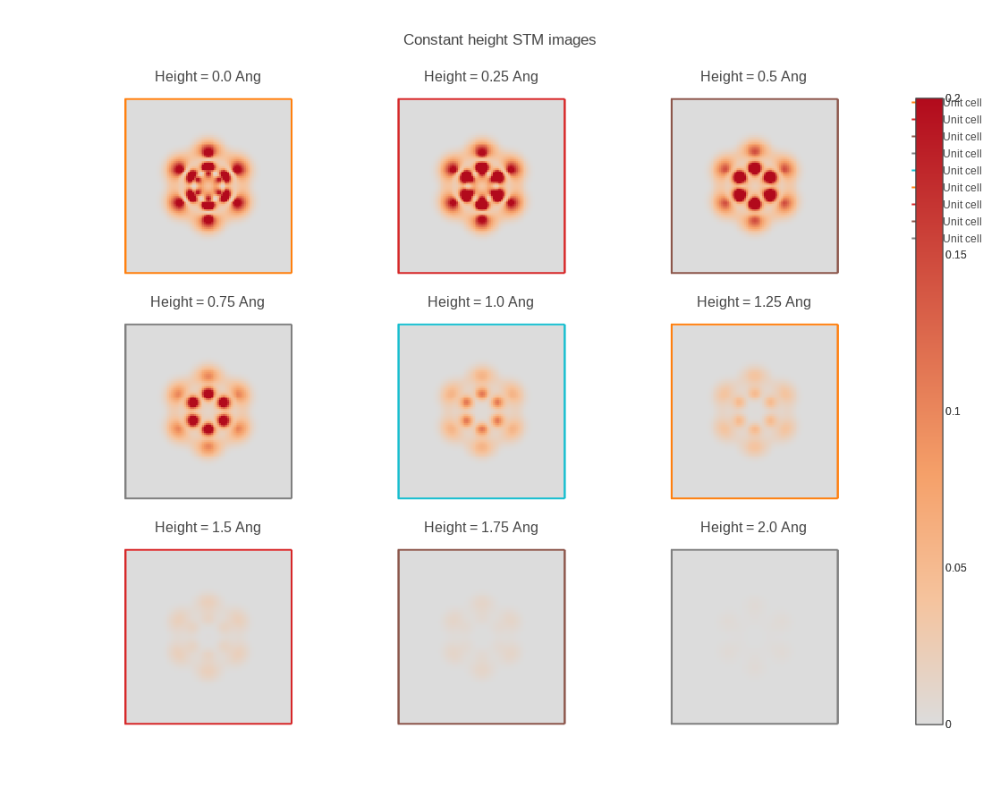

In [23]:
G.fill(0)                                   # buidem la informació que tenim guardada al grid G
V=10                                        # fixem l'energia fins on volem avaluar els LDOS (en aquets cas 10 eV).

for n in range(0,108):                      # definim un bucle que s'executi per les 108 funcions d'ona que tenim pel cas del benzè 
    
    if 0<eigenstate[n].eig<V:               # definim un condicional de mode que el que precedeuxi només s'executi per estats amb un valor propi amb energies entre 0 i V
        grid_t.fill(0)                      # buidem la informació que tenim guardada al grid_t
        eigenstate[n].wavefunction(grid_t)  # calculem la funció d'ona de l'estat n
        G_n = grid_t*grid_t                 # calculem la LDOS de l'estat n
        G = G + G_n                         # sumem la LDOS de l'estat n al grid G

# The helper function
def plot_STM_images(
    LDOS_grid: sisl.Grid, 
    min_height: int = 0,                    # fixem l'alçada mínima a 0 angstroms (i.e. la punta està en contacte amb la mostra)
    max_height: int = 2,                    # fixem l'alçada màxima a 2 angstroms (i.e. la punta està a 2 angroms de la mostra)
    steps: int = 9,                         # augmentem l'alçada de 0 a 2 angstroms en 9 intervals
    crange = None,
    colorscale: str = None
):
    """Plots constant height STM images at multiple heights

    Parameters
    ----------
    LDOS_grid:
        A grid containing the LDOS corresponding to the voltage that you
        want to plot, for ALL SPACE.
    min_height:
        The height of the first image.
    max_height:
        The height of the last image.
    steps:
        The number of steps between the first and the last image.
    log:
        Whether to plot the log of the values.
    crange:
        The range of the colorscale. E.g. [0, 2]. If None, it is computed
        from the minimum and maximum values of the data.
    colorscale:
        The plotly colorscale to use.

    Examples
    ----------

    This function should be used like:
    >>> grid = ...compute the LDOS in the grid.
    >>> plot_STM_images(grid)
    """

    # Determine all the heights that the user wants to plot
    heights = np.linspace(min_height, max_height, steps)
    # Get the position of the benzene molecule
    z_0 = G.geometry.xyz[:, 2].max()
    
    # Initialize a list of plots
    plots = []
    coloraxes = []
    # Loop through the heights, and for each of them we will create a plot.
    for height in heights:
        # Get the z for which we want the LDOS (benzene position + height)
        z = z_0 + height
        
        # Get the plot for this height
        plot = LDOS_grid.plot(axes="xy", z_range=[z - 0.1, z + 0.1], crange=crange, colorscale=colorscale)

        # And append it to the list
        plots.append(plot)

    # Merge all the plots, with some extra arguments to beautify the plot.
    return sisl.viz.merge_plots(
        *plots, 
        composite_method="subplots", 
        arrange="square", 
        subplot_titles=[f"Height = {height} Ang" for height in heights],
        horizontal_spacing=0,
        vertical_spacing=0.05
    ).update_xaxes(
        visible=False
    ).update_yaxes(
        visible=False
    ).update_layout(
        height=900, title=f"Constant height STM images",
    )

plot_STM_images(G, crange=[0, 0.2])      # fixem el màxim rang de crange a 0.2 ja que per un valor més gran no s'observa la LDOS per una altura de 2 Angstom

Grafiquem les imatges STM per **dos voltatges negatius**. Considerem -2.5 i -5 V, que ens mesuraran la LDOS per estats amb energies majors a 0 i menors a 2.5 i 5 eV, respectivament.

Imatges de STM en aplicar un voltatge de -2.5 V:


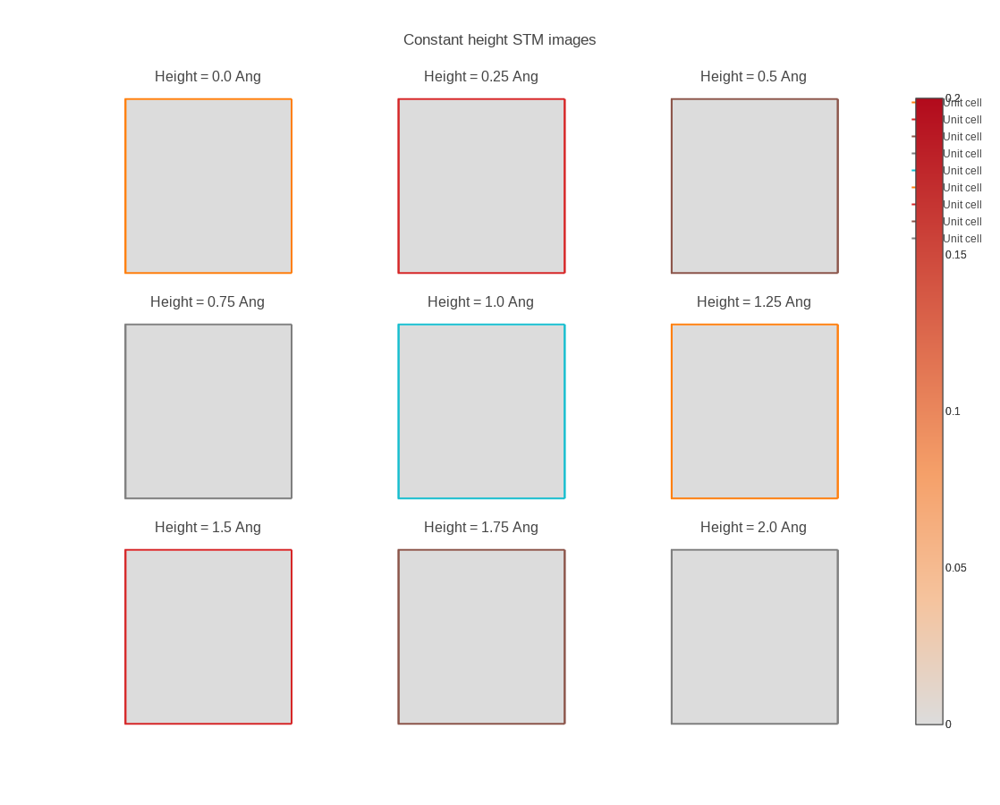

In [24]:
print("Imatges de STM en aplicar un voltatge de -2.5 V:")
plot_STM_images(STM_grid(2.5,hamiltonian), crange=[0, 0.2])

Observem que per energies entre 0 i 2.5 eV tenim una LDOS nul·la. Això es pot veure en el gràfic de PDOS en aquets interval, on no s'observa cap pic.

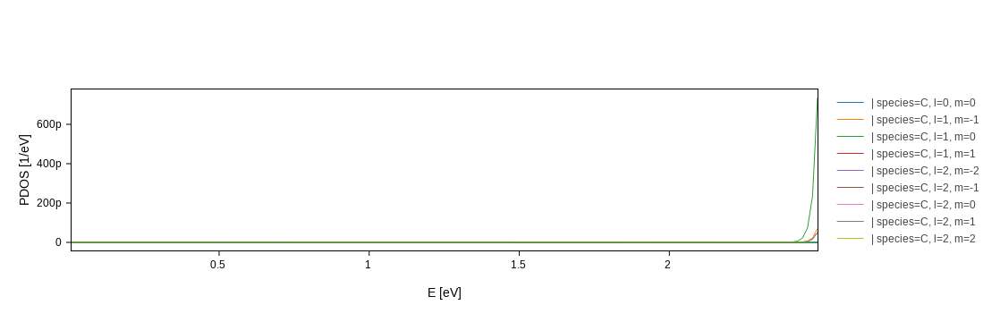

In [25]:
hamiltonian.plot.pdos(data_Erange=[-10, 10], nE=1200, Erange=[0, 2.5], kgrid=[1,1,1]).split_DOS(on="species+l+m")

Imatges de STM en aplicar un voltatge de -5 V:


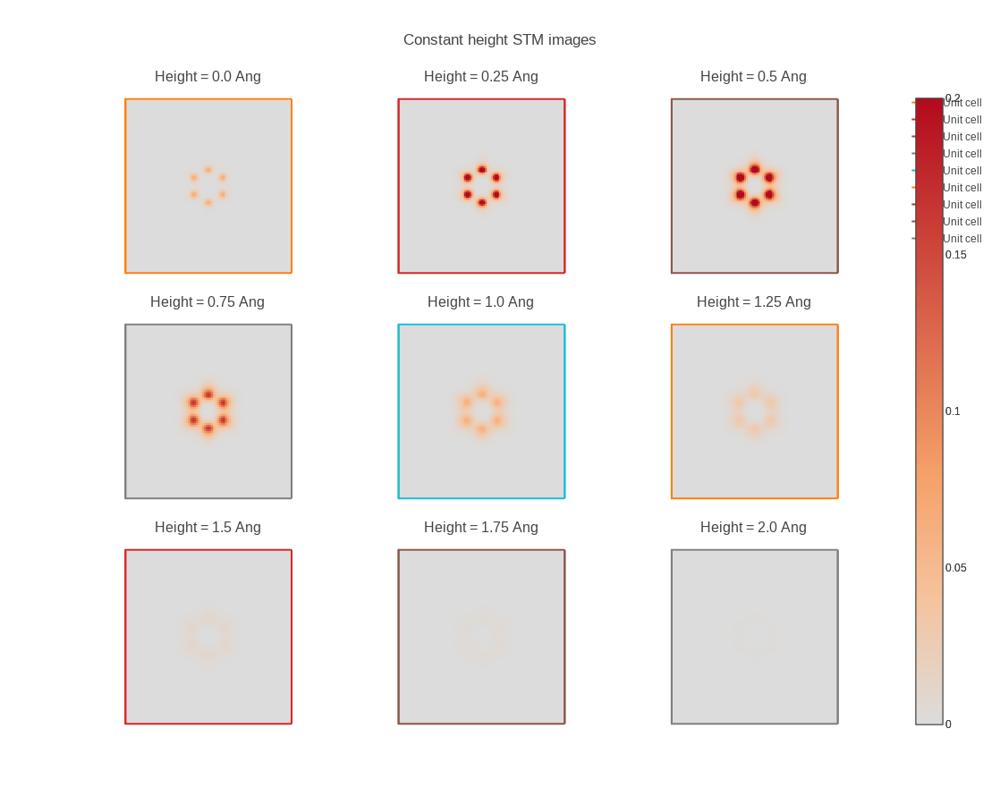

In [26]:
print("Imatges de STM en aplicar un voltatge de -5 V:")
plot_STM_images(STM_grid(5,hamiltonian), crange=[0, 0.2])

En aquest cas, observem que per energies entre 0 i 5 eV, sí observem una certa densitat d'estats. Això es pot observar en el gràfic de PDOS en aquest intrval d'energies. D'altra banda, podem veure com per distàncies punta-mostra molt baixes (<0,5 angstroms), la intensitat de la imatge STM disminueix. Això pot ser degut per diversos factors com la saturació del corrent de túnel, canvis en el règim de túnel i efectes d'interacció punta-mostra que alteren la densitat destats i la estabilitat del sistema.

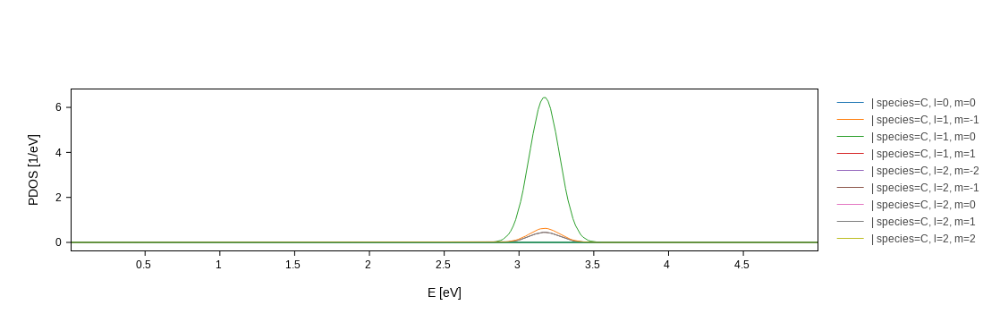

In [27]:
hamiltonian.plot.pdos(data_Erange=[-10, 10], nE=1200, Erange=[0, 5], kgrid=[1,1,1]).split_DOS(on="species+l+m")

Veiem que la principal contribució de LDOS en l'interval de 0 a 5 eV es deguda a l'orbital 2pz (l=1, m=0) del C.

Grafiquem les imatges STM per **dos voltatges positius**. Considerem +2.5 i +5.5 V, que ens mesuraran la LDOS per estats amb energies menors a 0 i majors a -2.5 i -5.5 eV, respectivament.

Primer, definim una nova funció que ens permeti veure els valors propis amb energia negativa:

In [28]:
def STM_grid_neg(V,H):
    G = sisl.Grid((100,100,100), geometry=geometry)
    G.fill(0)
    grid_t = sisl.Grid((100,100,100), geometry=geometry)
    eigenstate = H.eigenstate()
  
    for n in range(0,108):
            
        if V<eigenstate[n].eig<0:
            grid_t.fill(0)
            eigenstate[n].wavefunction(grid_t)
            G_n = grid_t*grid_t
            G = G + G_n
        
    return G

Imatges de STM en aplicar un voltatge de +2.5 V:


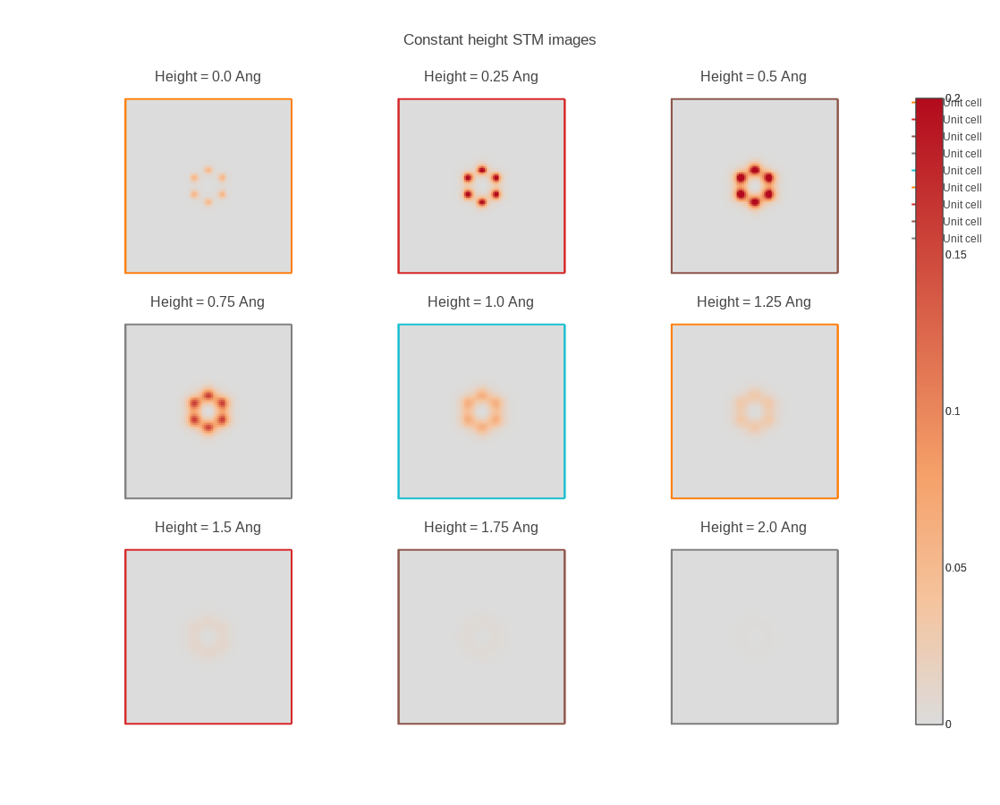

In [29]:
print("Imatges de STM en aplicar un voltatge de +2.5 V:")
plot_STM_images(STM_grid_neg(-2.5,hamiltonian), crange=[0, 0.2])

Per energies entre -2.5 i 0 eV observem una certa LDOS. Podem veure quins orbitals constribueixen a partir de la PDOS en aquets interval d'energies:

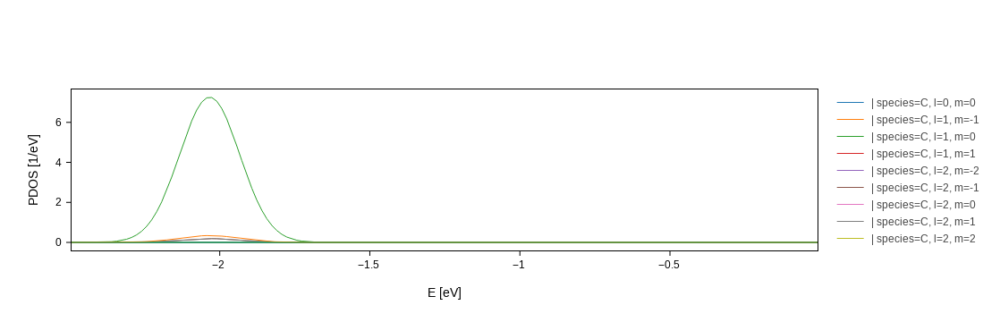

In [30]:
hamiltonian.plot.pdos(data_Erange=[-10, 10], nE=1200, Erange=[-2.5, 0], kgrid=[1,1,1]).split_DOS(on="species+l+m")

Observem que, igual que en el cas d'energies entre 0 i 5 eV, l'orbital amb una major contribució a la LDOS és l'orbital 2pz (l=1, m=0) del C. Això explica perquè tant les imatges de STM a 5 V com a -2.5 V tenen un aspecte molt similar.

Imatges de STM en aplicar un voltatge de +5.5 V:


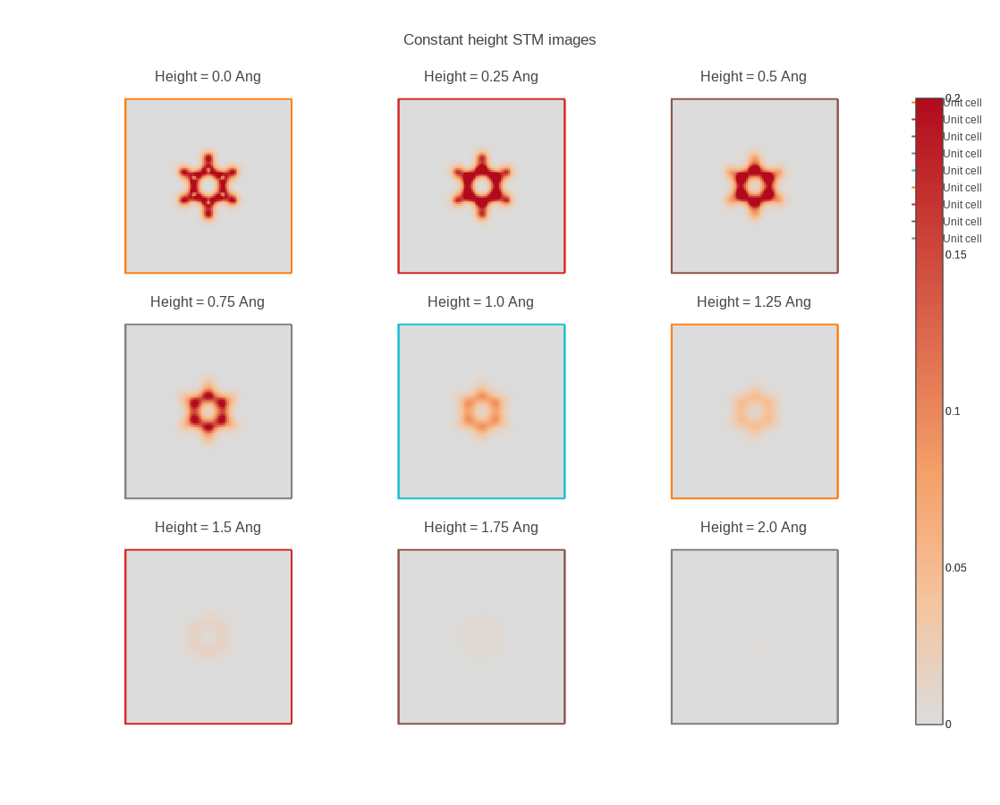

In [31]:
print("Imatges de STM en aplicar un voltatge de +5.5 V:")
plot_STM_images(STM_grid_neg(-5.5,hamiltonian), crange=[0, 0.2])

Per energies entre -5.5 i 0 eV les imatges STM que s'obtenen es mostren a dalt. Podem veure quins orbitals constribueixen a partir de la PDOS en aquets interval d'energies:

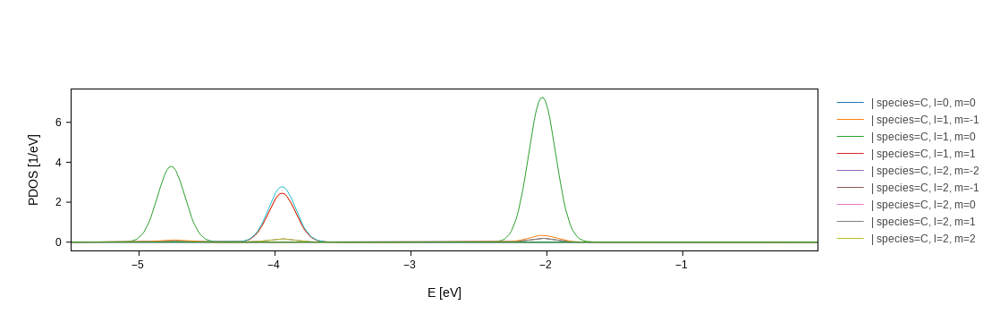

In [32]:
hamiltonian.plot.pdos(data_Erange=[-10, 10], nE=1200, Erange=[-5.5, 0], kgrid=[1,1,1]).split_DOS(on="species+l+m")

Les intensitats d'aquestes imatges s'expliquen degut a la LDOS corresponent principalment a l'orbital 2pz (l=1, m=0) del C. No obstant, els orbitals 2px (l=1, m=1) i 2py (l=1, m=-1) del C, i l'orbital 1s (l=0, m=0) del H també tenen una certa contribució.

BONUS: Imatges STM en un rang d'energies que no acabi ni comenci en 0 eV
---

Definim una funció que ens permeti calcular la LDOS entre dos valors d'energia conret, V_inf i V_sup (que no acabi ni comenci en 0 eV):

In [33]:
def STM_grid_rang(V_inf,V_sup,H):                              # definim una funció que depèn de "V_inf", "V_sup" i "H", i l'anomenem "STM_grid"
    G = sisl.Grid((100,100,100), geometry=geometry)       # definim el grid G
    G.fill(0)                                             # buidem la informació del grid G
    grid_t = sisl.Grid((100,100,100), geometry=geometry)  # definim un grid buit que anomenem grid_t 
    eigenstate = H.eigenstate()                           # definim els valors propis del hamiltonià "H" com "eigenstate"
  
    for n in range(0,108):                                # definim un bucle que s'executi per les 108 funcions d'ona que tenim pel cas del benzè
            
        if V_inf<eigenstate[n].eig<V_sup:                 # definim un condicional de mode que el que precedeix només s'executi per estats amb un valor propi amb energies entre V_inf i V_sup
            grid_t.fill(0)                                # buidem la informació que tenim guardada al grid_t
            eigenstate[n].wavefunction(grid_t)            # calculem la funció d'ona de l'estat n
            G_n = grid_t*grid_t                           # calculem la LDOS de l'estat n
            G = G + G_n                                   # sumem la LDOS de l'estat n al grid G
        
    return G                                              # retorna la LDOS en funció de les variables V i H indicades

Podem calcular la LDOS que obtindíem en estats de -9 a -4 eV com:

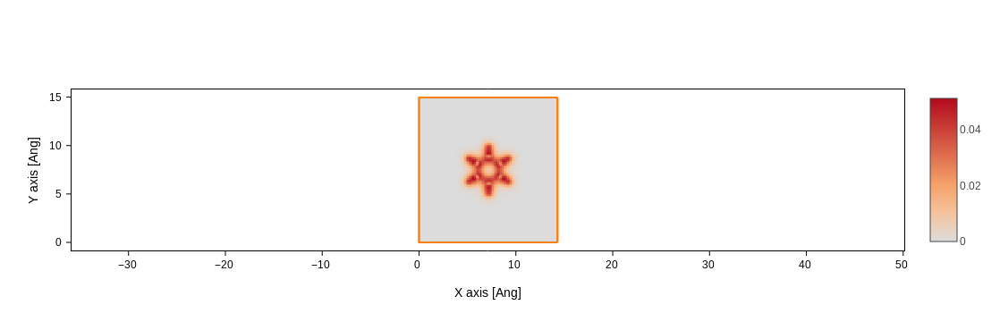

In [34]:
STM_grid_rang(-9,-4,hamiltonian).plot(axes='xy')

Les imatges de STM que obtindríem si poguèssim aplicar un voltatge per mesurar els estats entre -9 i -4 eV es veurien així:

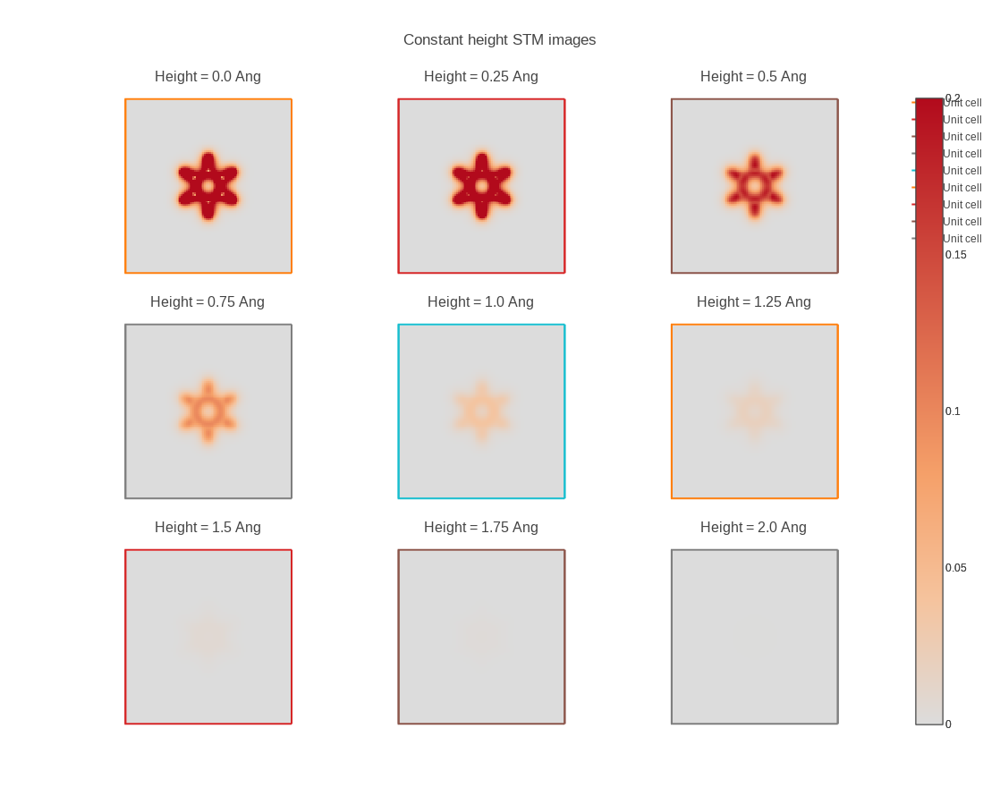

In [35]:
plot_STM_images(STM_grid_rang(-9,-4,hamiltonian), crange=[0, 0.2])

Si representem la PDOS per aquest rang observem que:

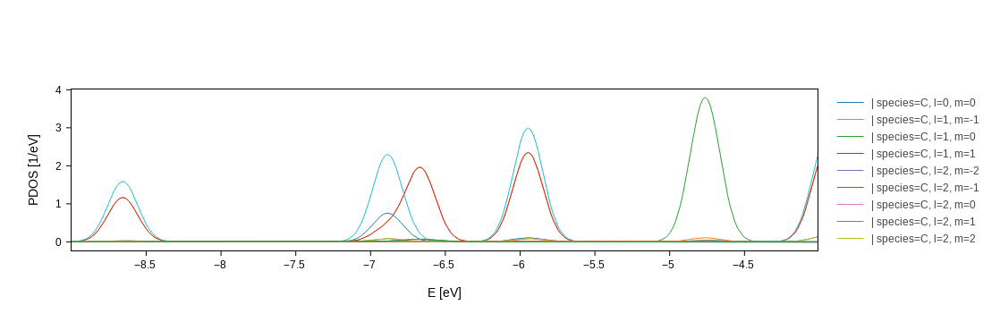

In [36]:
hamiltonian.plot.pdos(data_Erange=[-10, 10], nE=1200, Erange=[-9, -4], kgrid=[1,1,1]).split_DOS(on="species+l+m")

Observem que per un rang de -9 a -4 eV, els orbitals que contribueixen a la LDOS són els orbitals 2pz (l=1, m=0), 2px (l=1, m=1) i 2py (l=1, m=-1) del C, i l'orbital 1s (l=0, m=0) del H.

Per mesurar experimentalment la LDOS en un rang de -9 a -4 eV utilitzant STM, caldria utilitzar la tècnica d'**espectroscòpia d'escombrat d'energia diferencial (dI/dV)**. Primer, es mesurarien els senyals de conductància diferencial (dI/dV) a diferents voltatges dins del rang dinterès. Després, aquests senyals s'integrarien per obtenir la contribució acumulativa de la LDOS en aquest rang d'energies. Finalment, s'utilitzarien les dades integrades per construir una imatge STM que reflecteixi la distribució espacial de la LDOS al rang específic de -9 a -4 eV.